In [1]:
# LOADING THE MODEL AND DATA

# Load the model
import torch
from anomaly_detection.models.cvae3d import CVAE3D
from anomaly_detection.config.config_handler import get_config

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
config = get_config('/home/ssulta24/Desktop/VCAE_new/anomaly_detection/config/config.yaml')
model = CVAE3D(config).to(device)
model.load_state_dict(torch.load(
    '/home/ssulta24/Desktop/VCAE_new/wandb/run-20241006_160824-x3tu4esv/files/best_model.pth', 
    map_location=device, 
    weights_only=False
))
model.eval()

# Load the data
from anomaly_detection.data.data_loader_V2 import EELSDataset
data = EELSDataset(config)
dataset = data.get_preprocessed_data()
energy_values = data.get_cropped_energy_values()

In [18]:
# ANOMALY INJECTION UTILS 
import matplotlib.pyplot as plt
from scipy import signal
from scipy.signal import fftconvolve
from scipy.ndimage import gaussian_filter1d
import numpy as np

################################################################
########################### UTILS ##############################
################################################################

def find_peaks(spectrum, prominence=0.1, distance=1, plot=False):
    """
    Find peaks in the spectrum using scipy's find_peaks function.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    prominence (float): Minimum prominence of the peaks (relative to the maximum intensity)
    distance (int): Minimum distance between peaks
    plot (bool): If True, plot the spectrum with detected peaks
    
    Returns:
    tuple: (peak_positions, peak_properties)
    """
    prominence = prominence * np.max(spectrum)
    peaks, properties = signal.find_peaks(spectrum, prominence=prominence, distance=distance)
    
    if plot:
        plot_spectrum_with_peaks(spectrum, peaks, properties)
    
    return peaks, properties

def plot_spectrum_with_peaks(spectrum, peaks, properties):
    """
    Plot the spectrum with detected peaks.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    peaks (numpy.ndarray): Array of peak indices
    properties (dict): Properties of the peaks
    """
    plt.figure(figsize=(12, 6))
    plt.plot(spectrum)
    plt.plot(peaks, spectrum[peaks], "x")
    
    # Highlighting the most prominent peak
    most_prominent = peaks[np.argmax(properties['prominences'])]
    plt.plot(most_prominent, spectrum[most_prominent], "o", color='red', markersize=10)
    
    plt.title("Spectrum with Detected Peaks (Red circle: Most Prominent)")
    plt.xlabel("Channel")
    plt.ylabel("Intensity")
    plt.show()

def find_main_peak(spectrum, plot=False):
    """
    Find the main peak in the spectrum based on highest prominence.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    plot (bool): If True, plot the spectrum with the main peak
    
    Returns:
    int: The index of the main peak
    """
    peaks, properties = find_peaks(spectrum, prominence=0.1, distance=10)
    if len(peaks) == 0:
        main_peak = np.argmax(spectrum)
    else:
        # Select the peak with the highest prominence
        main_peak = peaks[np.argmax(properties['prominences'])]
    
    if plot:
        plot_spectrum_with_peaks(spectrum, [main_peak], {'prominences': [properties['prominences'][np.argmax(properties['prominences'])]]})
    
    return main_peak

def create_circular_mask(h, w, center_y, center_x, radius, antialiased=True):
    """
    Create a circular mask for anomaly injection with optional anti-aliasing.
    
    Args:
    h, w (int): Height and width of the mask
    center_y, center_x (int): Center coordinates of the circle
    radius (int): Radius of the circle
    antialiased (bool): Whether to apply anti-aliasing to the circle edge
    
    Returns:
    numpy.ndarray: Mask with values between 0 and 1, where edge pixels are partially filled
    """
    y, x = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((y - center_y)**2 + (x - center_x)**2)
    
    if antialiased:
        # Create smooth transition at edges
        inner_radius = radius - 0.5
        outer_radius = radius + 0.5
        
        # Core of circle (fully inside)
        mask = np.zeros((h, w), dtype=float)
        mask[dist_from_center <= inner_radius] = 1.0
        
        # Edge pixels (partial coverage)
        edge_pixels = (dist_from_center > inner_radius) & (dist_from_center < outer_radius)
        mask[edge_pixels] = 1.0 - (dist_from_center[edge_pixels] - inner_radius)
        
        return mask
    else:
        # Binary mask without anti-aliasing
        return dist_from_center <= radius

def inject_controlled_anomalies(image, anomaly_specs, energy_range=None):
    """
    Inject controlled anomalies into the EELS image using anti-aliased circular regions.
    
    Args:
    image (numpy.ndarray): Input image of shape (height, width, energy_channels)
    anomaly_specs (list): List of tuples specifying anomalies. Each tuple can be either:
        - (type, count, radius) for basic usage
        - (type, count, radius, dict) where dict contains specific parameters
    energy_range (numpy.ndarray, optional): Energy values for oxygen deficiency simulation
    
    Returns:
    tuple: (anomalous_image, anomaly_mask)
    """
    anomalous_image = np.copy(image)
    height, width, _ = image.shape
    anomaly_mask = np.zeros((height, width), dtype=float)  # Changed to float for anti-aliasing
    
    anomaly_funcs = {
        'peak_shift': peak_shift,
        'peak_broadening': peak_broadening,
        'intensity_fluctuation': intensity_fluctuation,
        'background_slope': background_slope,
        'noise_injection': noise_injection,
        'multiple_scattering': multiple_scattering,
        'cosmic_ray': cosmic_ray,
        'oxygen_deficiency': simulate_oxygen_deficiency
    }
    
    anomaly_colors = {
        'peak_shift': 1,
        'peak_broadening': 2,
        'intensity_fluctuation': 3,
        'background_slope': 4,
        'noise_injection': 5,
        'multiple_scattering': 6,
        'cosmic_ray': 7,
        'oxygen_deficiency': 8
    }
    
    for spec in anomaly_specs:
        # Unpack specifications
        if len(spec) == 4:
            anomaly_type, count, radius, params = spec
        else:
            anomaly_type, count, radius = spec
            params = {}
        
        for _ in range(count):
            if anomaly_type == 'cosmic_ray':
                # Handle cosmic ray as a single point anomaly
                while True:
                    y = np.random.randint(0, height)
                    x = np.random.randint(0, width)
                    if anomaly_mask[y, x] == 0:
                        anomaly_mask[y, x] = anomaly_colors[anomaly_type]
                        anomalous_image[y, x] = anomaly_funcs[anomaly_type](
                            anomalous_image[y, x], **params)
                        break
            else:
                # For other anomaly types, create anti-aliased circular regions
                max_attempts = 100
                attempt = 0
                
                while attempt < max_attempts:
                    center_y = np.random.randint(radius, height - radius)
                    center_x = np.random.randint(radius, width - radius)
                    
                    # Create anti-aliased circular mask
                    circle_mask = create_circular_mask(height, width, center_y, center_x, radius)
                    
                    # Check if the region is available (using a threshold for the anti-aliased mask)
                    if np.all(anomaly_mask[circle_mask > 0.1] == 0):
                        # For visualization, use the anomaly color value
                        anomaly_mask[circle_mask > 0] = anomaly_colors[anomaly_type] * circle_mask[circle_mask > 0]
                        
                        # Apply the anomaly with intensity proportional to the mask value
                        for y, x in zip(*np.where(circle_mask > 0)):
                            if anomaly_type == 'oxygen_deficiency' and energy_range is not None:
                                modified_spectrum = anomaly_funcs[anomaly_type](
                                    anomalous_image[y, x], energy_range, **params)
                            else:
                                modified_spectrum = anomaly_funcs[anomaly_type](
                                    anomalous_image[y, x], **params)
                            
                            # Blend the modified spectrum with the original based on mask value
                            blend_factor = circle_mask[y, x]
                            anomalous_image[y, x] = (blend_factor * modified_spectrum + 
                                                   (1 - blend_factor) * anomalous_image[y, x])
                        break
                    
                    attempt += 1
                
                if attempt >= max_attempts:
                    print(f"Warning: Could not place anomaly of type {anomaly_type} after {max_attempts} attempts")
    
    return anomalous_image, anomaly_mask

def simulate_oxygen_deficiency(original_spec, energy_range=energy_values, deficiency_level=0.1, ok_edge_start=533):
    """
    Simulate oxygen deficiency with effects only applied to O K-edge region and beyond
    
    Parameters:
    -----------
    original_spec : array-like
        Original XAS spectrum
    energy_range : array-like
        Energy values
    deficiency_level : float
        Degree of oxygen deficiency to simulate (0-1)
    ok_edge_start : float
        Energy value where O K-edge region starts
    """
    # Create mask for O K-edge region and beyond
    ok_edge_mask = (energy_range >= ok_edge_start) & (energy_range <= ok_edge_start + 30)
    
    # Create modified spectrum
    modified_spec = original_spec.copy()
    
    # Only apply effects to O K-edge region
    edge_energies = energy_range[ok_edge_mask]
    edge_spec = modified_spec[ok_edge_mask]
    
    # Normalize the O K-edge portion
    edge_spec = (edge_spec - np.min(edge_spec)) / (np.max(edge_spec) - np.min(edge_spec))
    
    # Create energy normalization only for O K-edge region
    energy_normalized = (edge_energies - np.min(edge_energies)) / (np.max(edge_energies) - np.min(edge_energies))
    
    # Create sigmoid transitions for amplitude reduction
    sigmoid1 = 1 / (1 + np.exp(-(energy_normalized - 0.3) * 10))
    sigmoid2 = 1 / (1 + np.exp(-(energy_normalized - 0.6) * 15))
    
    # Combine sigmoids for complex amplitude reduction pattern
    amplitude_factor = 1 - (deficiency_level * (0.7 * sigmoid1 + 0.3 * sigmoid2))
    
    # Apply amplitude reduction only to edge region
    edge_spec *= amplitude_factor
    
    # Apply gaussian blur with varying sigma only to edge region
    sigma = deficiency_level * (0.5 + energy_normalized * 3.0)
    edge_spec = gaussian_filter1d(edge_spec, sigma=np.max(sigma))
    
    # Apply small shift only to edge region
    shift_amount = int(deficiency_level * 8)
    edge_spec = np.roll(edge_spec, -shift_amount)
    if shift_amount > 0:
        edge_spec[-shift_amount:] = edge_spec[-(shift_amount+1)]
    
    # Rescale edge_spec back to original range
    edge_range = np.max(original_spec[ok_edge_mask]) - np.min(original_spec[ok_edge_mask])
    edge_min = np.min(original_spec[ok_edge_mask])
    edge_spec = (edge_spec * edge_range) + edge_min
    
    # Insert modified edge region back into spectrum
    modified_spec[ok_edge_mask] = edge_spec
    
    return modified_spec

def peak_shift(spectrum, shift_value=25, window_size=20): 
    """
    Apply peak shift to the spectrum.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    shift_value (int, optional): If provided, shift will be randomly +/- this value
    window_size (int): Size of the window around the peak to apply the shift
    
    Returns:
    numpy.ndarray: The shifted spectrum
    """
    peak_pos = find_main_peak(spectrum)
    
    # Randomly choose between positive and negative shift
    shift = shift_value * (2 * np.random.randint(0, 2) - 1)  # Returns either +shift_value or -shift_value
    window = slice(max(0, peak_pos - window_size), min(len(spectrum), peak_pos + window_size + 1))
    shifted_spectrum = np.roll(spectrum[window], shift)
    spectrum[window] = shifted_spectrum
    return spectrum

def peak_broadening(spectrum, max_sigma=5): # WORKS OK
    peak_pos = find_main_peak(spectrum)
    window_size = 51  # Adjust this value based on your typical peak widths
    window = slice(max(0, peak_pos - window_size//2), min(len(spectrum), peak_pos + window_size//2 + 1))
    peak_region = spectrum[window]
    sigma = np.random.uniform(0, max_sigma)
    x = np.arange(-window_size//2, window_size//2 + 1)
    gaussian = np.exp(-x**2 / (2 * sigma**2))
    gaussian /= gaussian.sum()
    broadened_peak = fftconvolve(peak_region, gaussian, mode='same')
    broadened_peak *= np.sum(peak_region) / np.sum(broadened_peak)
    result = spectrum.copy()
    result[window] = broadened_peak
    return result

def intensity_fluctuation(spectrum, scale_range=None): # WORKS WELL 
    """
    Apply intensity fluctuation to the spectrum.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    scale_range (tuple): A tuple of (min_scale, max_scale). If None, default to (0.8, 1.2)
    
    Returns:
    numpy.ndarray: The spectrum with intensity fluctuation applied
    """
    if scale_range is None:
        scale_range = (0.8, 1.2)
    scale = np.random.uniform(scale_range[0], scale_range[1])
    return spectrum * scale

def background_slope(spectrum, max_slope=0.00013): # WORKS WELL 
    slope = np.random.uniform(-max_slope, max_slope)
    background = np.arange(len(spectrum)) * slope
    return spectrum + background

def noise_injection(spectrum, poisson_factor=0.0005, gaussian_std=0.09): # WORKS WELL 
    poisson_noise = np.random.poisson(poisson_factor * spectrum)
    gaussian_noise = np.random.normal(0, gaussian_std * np.mean(spectrum), len(spectrum))
    return spectrum + poisson_noise + gaussian_noise

def multiple_scattering(spectrum, scattering_factor=0.1): # WORKS WELL 
    convolved = np.convolve(spectrum, spectrum, mode='same')
    return spectrum + scattering_factor * convolved / np.max(convolved)

def cosmic_ray(spectrum, intensity_factor=10, width=3): # WORKS WELL 
    """
    Add a cosmic ray spike to the spectrum.
    
    Args:
    spectrum (numpy.ndarray): The input spectrum
    intensity_factor (float): Factor to determine the intensity of the cosmic ray
    width (int): Width of the cosmic ray peak
    
    Returns:
    numpy.ndarray: The spectrum with an added cosmic ray spike
    """
    pos = np.random.randint(len(spectrum))
    x = np.arange(2 * width + 1) - width
    gaussian_peak = gaussian(x, 0, width/3)
    start = max(0, pos - width)
    end = min(len(spectrum), pos + width + 1)
    peak_start = width - (pos - start)
    peak_end = width + (end - pos)
    spectrum[start:end] += intensity_factor * np.max(spectrum) * gaussian_peak[peak_start:peak_end]
    return spectrum

def gaussian(x, mu, sig):
    return np.exp(-np.power(x - mu, 2.) / (2 * np.power(sig, 2.)))

In [19]:
# UTILS FOR RECONSTRUCTION WITH VAE AND ERROR MAP CALCULATION 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy.stats import pearsonr
import torch
from tqdm import tqdm
import hyperspy.api as hs
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from scipy.signal import correlate
from scipy.spatial.distance import cosine
from dtaidistance import dtw
from sklearn.metrics import mean_squared_error
from scipy.stats import wasserstein_distance
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw
import multiprocessing as mp
from enum import Enum

def adjust_energy_dimension(data, target_points=1312):
    """
    Adjust the energy dimension of the data to exactly 1312 points
    by centering around the middle of the available range
    
    Args:
        data: numpy array of shape (height, width, energy_points)
        target_points: desired number of points in energy dimension (default: 1312)
    
    Returns:
        adjusted_data: numpy array with energy dimension of exactly target_points
    """
    height, width, energy_points = data.shape
    
    # Find the middle point of the current energy range
    mid_idx = energy_points // 2
    half_target = target_points // 2
    
    # Calculate start and end indices
    start_idx = max(0, mid_idx - half_target)
    end_idx = min(energy_points, start_idx + target_points)
    
    # If we hit the upper bound, adjust the start index
    if end_idx == energy_points:
        start_idx = end_idx - target_points
    # If we hit the lower bound, adjust the end index
    elif start_idx == 0:
        end_idx = target_points
    
    # Crop the data
    adjusted_data = data[..., start_idx:end_idx]
    
    print(f"Original energy points: {energy_points}")
    print(f"Adjusted energy points: {adjusted_data.shape[-1]}")
    
    return adjusted_data

def split_into_shards(data, shard_size=24):
    """
    Split data into 24x24 shards with exactly 1312 energy points
    
    Args:
        data: numpy array of shape (height, width, energy_points)
        shard_size: size of each square shard
        target_energy_points: desired number of points in energy dimension
    
    Returns:
        shards: list of numpy arrays, each of shape (shard_size, shard_size, target_energy_points)
        positions: list of tuples containing (i, j) start positions of each shard
    """
    # First adjust the energy dimension
    height, width, energy_points = data.shape
        
    shards = []
    positions = []
    
    # Calculate number of complete shards in each dimension
    n_shards_h = height // shard_size
    n_shards_w = width // shard_size
    
    print(f"Will create {n_shards_h * n_shards_w} complete shards of size {shard_size}x{shard_size}")
    
    for i in range(0, height - shard_size + 1, shard_size):
        for j in range(0, width - shard_size + 1, shard_size):
            # Extract shard
            shard = data[i:i+shard_size, j:j+shard_size, :]
            shards.append(shard)
            positions.append((i, j))
            
    # Print information about the shards
    if len(shards) > 0:
        print(f"Individual shard shape: {shards[0].shape}")
    print(f"Number of shards created: {len(shards)}")
    
    return shards, positions

def reconstruct_from_shards(shards, positions, full_shape, shard_size=24):
    """
    Reconstruct full image from shards
    
    Args:
        shards: list of numpy arrays of shape (shard_size, shard_size, energy_points)
        positions: list of tuples containing (i, j) start positions
        full_shape: tuple of (height, width, energy_points)
        shard_size: size of each square shard
    
    Returns:
        reconstructed: numpy array of shape full_shape
    """
    height, width, energy_points = full_shape
    reconstructed = np.zeros(full_shape)
    
    for shard, (i, j) in zip(shards, positions):
        reconstructed[i:i+shard_size, j:j+shard_size, :] = shard
    
    return reconstructed

def process_data_with_vae(data, model, device, shard_size=24):
    """Process entire dataset through VAE using shards"""
    
    # Split adjusted data into shards
    shards, positions = split_into_shards(data, shard_size)
    reconstructed_shards = []
    
    print("Processing shards through VAE...")
    for shard in tqdm(shards):
        # Process through VAE
        with torch.no_grad():
            shard_tensor = torch.tensor(shard).unsqueeze(0).unsqueeze(0).float().to(device)
            mean, logvar = model.encode(shard_tensor)
            z = model.reparameterize(mean, logvar)
            reconstructed_shard = model.decode(z).squeeze().cpu().numpy()
            reconstructed_shards.append(reconstructed_shard)
    
    # Reconstruct full image using adjusted shape
    height, width, energy = data.shape
    adjusted_shape = (height, width, energy)
    reconstructed_data = reconstruct_from_shards(reconstructed_shards, positions, adjusted_shape)
    
    return reconstructed_data

class Algorithm(Enum):
    PCC = "pcc"  # Pearson Correlation Coefficient
    DTW = "dtw"  # Dynamic Time Warping
    MSE = "mse"  # Mean Squared Error
    SPE = "spe"  # Spearman Correlation
    EMD = "emd"  # Wasserstein Distance

def calculate_metric(spec1, spec2, algorithm, range_start=900, range_end=1025):
    """Calculate chosen metric for spectra within specified range"""
    spec1_range = spec1[range_start:range_end]
    spec2_range = spec2[range_start:range_end]
    
    if algorithm == Algorithm.PCC:
        metric, _ = pearsonr(spec1_range, spec2_range)
    elif algorithm == Algorithm.DTW:
        metric = dtw.distance(spec1_range, spec2_range)
    elif algorithm == Algorithm.MSE:
        metric = np.mean((spec1_range - spec2_range)**2)
    elif algorithm == Algorithm.SPE:
        metric, _ = spearmanr(spec1_range, spec2_range)
    elif algorithm == Algorithm.EMD:
        metric = wasserstein_distance(spec1_range, spec2_range) 
    else:
        raise ValueError(f"Unknown algorithm: {algorithm}")
        
    return metric

def process_pairs_chunk(args):
    """
    Process a chunk of spectra pairs
    args: tuple of (pairs_chunk, algorithm)
    pairs_chunk: list of (i, j, data1[i,j], data2[i,j], range_start, range_end)
    """
    pairs_chunk, algorithm = args
    results = []
    for i, j, spec1, spec2, range_start, range_end in pairs_chunk:
        metric = calculate_metric(spec1, spec2, algorithm, range_start, range_end)
        results.append((i, j, metric))
    return results

def calculate_similarity_map(data1, data2, algorithm=Algorithm.PCC, range_start=900, range_end=1025, n_cores=None):
    """
    Calculate similarity map for two datasets using parallel processing
    
    Parameters:
    -----------
    data1, data2 : numpy.ndarray
        Input spectral datasets with shape (height, width, spectral_length)
    algorithm : Algorithm
        Similarity metric to use (PCC, DTW, MSE, or SPE)
    range_start, range_end : int
        Spectral range to analyze
    n_cores : int, optional
        Number of CPU cores to use. Defaults to number of CPU cores - 1
    
    Returns:
    --------
    numpy.ndarray
        2D map of similarity metrics
    """
    if n_cores is None:
        n_cores = mp.cpu_count() - 1
    
    shape = data1.shape[:-1]
    similarity_map = np.zeros(shape)
    
    # Create pairs for processing
    pairs = []
    for i in range(shape[0]):
        for j in range(shape[1]):
            pairs.append((i, j, data1[i,j], data2[i,j], range_start, range_end))
    
    # Calculate chunk size
    n_pairs = len(pairs)
    chunk_size = max(1, n_pairs // n_cores)
    
    # Split pairs into chunks
    chunks = []
    for i in range(0, n_pairs, chunk_size):
        chunk = pairs[i:i + chunk_size]
        chunks.append((chunk, algorithm))
    
    print(f"Processing {n_pairs} pairs in {len(chunks)} chunks using {n_cores} cores")
    
    # Process in parallel
    with mp.Pool(processes=n_cores) as pool:
        chunk_results = list(tqdm(
            pool.imap(process_pairs_chunk, chunks),
            total=len(chunks),
            desc=f"Processing {algorithm.value} analysis"
        ))
    
    # Flatten results and fill the map
    for chunk_result in chunk_results:
        for i, j, metric in chunk_result:
            similarity_map[i,j] = metric
    
    # Create visualizations
    plt.figure(figsize=(15, 6))
    
    # Adjust visualization based on algorithm
    if algorithm in [Algorithm.PCC, Algorithm.SPE]:
        vmin, vmax = -1, 1
    else:  # DTW and MSE are always positive
        vmin, vmax = 0, np.max(similarity_map)
    
    plt.imshow(similarity_map, cmap='RdYlBu_r', vmin=vmin, vmax=vmax)
    plt.colorbar(label=algorithm.value.upper())
    plt.title(f'{algorithm.value.upper()}: Comparison Map')
    
    plt.tight_layout()
    plt.savefig(f"{algorithm.value}_2DMAP.png")
    plt.close()

    # Create histogram
    plt.figure(figsize=(10, 6))
    plt.hist(similarity_map.flatten(), bins=50, density=True)
    plt.xlabel(f'{algorithm.value.upper()} Value')
    plt.ylabel('Density')
    plt.title(f'{algorithm.value.upper()} Distribution')
    plt.savefig(f"{algorithm.value}_HISTOGRAM.png")
    plt.close()
    
    return similarity_map

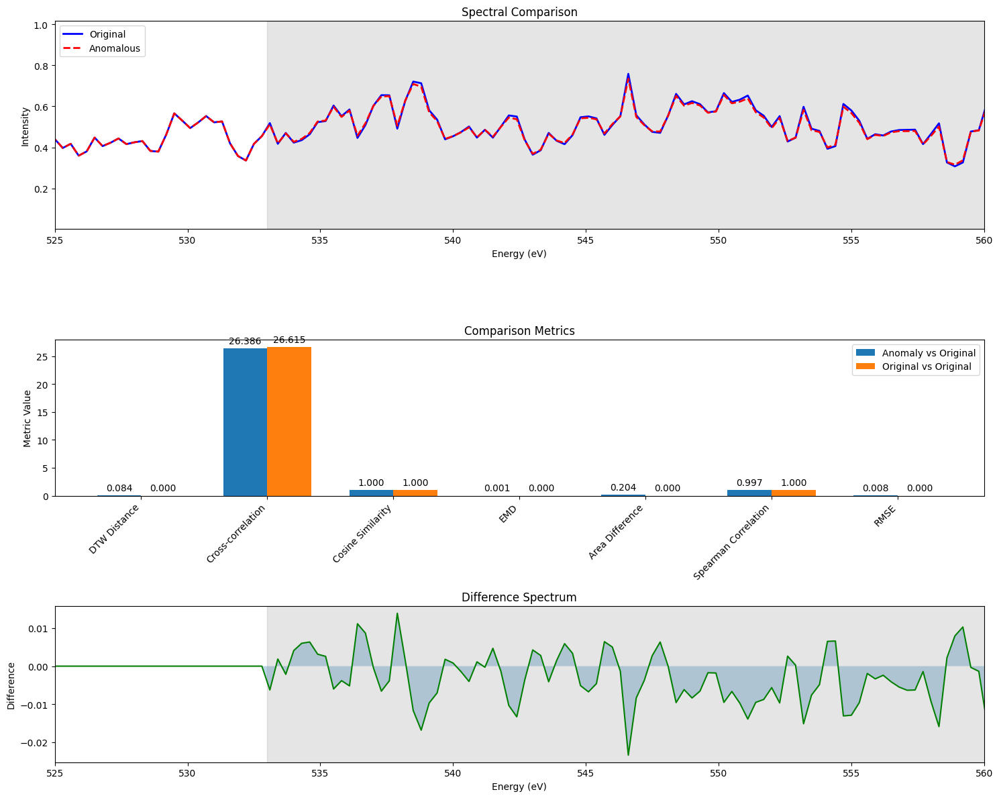

In [4]:
# Compare two spectra using multiple metrics
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from scipy.signal import correlate
from scipy.spatial.distance import cosine
from dtaidistance import dtw
from sklearn.metrics import mean_squared_error
from scipy.stats import wasserstein_distance
import hyperspy.api as hs

def compare_spectra(spec1, spec2, energy_range, methods=['all']):
    """
    Compare two spectra using multiple metrics including EMD
    """
    # Use the O K-edge region mask
    edge_mask = (energy_range >= 533) & (energy_range <= 533 + 30)
    edge_energies = energy_range[edge_mask]
    
    # Normalize spectra
    spec1_norm = (spec1 - np.min(spec1)) / (np.max(spec1) - np.min(spec1))
    spec2_norm = (spec2 - np.min(spec2)) / (np.max(spec2) - np.min(spec2))
    
    # Get masked spectra
    spec1_masked = spec1_norm[edge_mask]
    spec2_masked = spec2_norm[edge_mask]
    
    results = {}
    
    if 'dtw' in methods or 'all' in methods:
        distance = dtw.distance(spec1_masked, spec2_masked)
        results['DTW Distance'] = distance
    
    if 'xcorr' in methods or 'all' in methods:
        correlation = correlate(spec1_masked, spec2_masked, mode='full')
        max_corr = np.max(correlation)
        results['Cross-correlation'] = max_corr
    
    if 'cosine' in methods or 'all' in methods:
        cos_sim = 1 - cosine(spec1_masked, spec2_masked)
        results['Cosine Similarity'] = cos_sim
    
    if 'emd' in methods or 'all' in methods:
        # Calculate EMD (Wasserstein distance)
        # Normalize energies to [0,1] for consistent scale
        energies_norm = (edge_energies - np.min(edge_energies)) / (np.max(edge_energies) - np.min(edge_energies))
        emd = wasserstein_distance(energies_norm, energies_norm, spec1_masked, spec2_masked)
        results['EMD'] = emd
    
    if 'area' in methods or 'all' in methods:
        area_diff = np.trapz(np.abs(spec1_masked - spec2_masked), edge_energies)
        results['Area Difference'] = area_diff
    
    if 'spearman' in methods or 'all' in methods:
        spearman_corr, _ = spearmanr(spec1_masked, spec2_masked)
        results['Spearman Correlation'] = spearman_corr
    
    if 'rmse' in methods or 'all' in methods:
        rmse = np.sqrt(mean_squared_error(spec1_masked, spec2_masked))
        results['RMSE'] = rmse
    
    return results

def visualize_comparison_results(original_data, anomalous_data, anomaly_mask, energy_values):
    """
    Create comprehensive visualization of spectral comparisons including EMD
    """
    # Get coordinates of anomalous pixels
    anomaly_coords = np.argwhere(anomaly_mask > 0)
    
    # Create figure with subplots
    fig = plt.figure(figsize=(15, 12))
    gs = fig.add_gridspec(3, 2, height_ratios=[2, 1.5, 1.5])
    
    # 1. Spectrum comparison plot
    ax1 = fig.add_subplot(gs[0, :])
    pixel_y, pixel_x = anomaly_coords[0]
    
    # Get original and anomalous spectra
    original_spectrum = original_data[pixel_y, pixel_x]
    anomalous_spectrum = anomalous_data[pixel_y, pixel_x]
    
    # Plot spectra
    ax1.plot(energy_values, original_spectrum, 'b-', label='Original', linewidth=2)
    ax1.plot(energy_values, anomalous_spectrum, 'r--', label='Anomalous', linewidth=2)
    ax1.set_xlabel('Energy (eV)')
    ax1.set_ylabel('Intensity')
    ax1.set_title('Spectral Comparison')
    ax1.set_xlim(525, 560)
    ax1.legend()
    
    # Add O K-edge region highlight
    ax1.axvspan(533, 563, color='gray', alpha=0.2, label='O K-edge region')
    
    # 2. Metrics comparison plot
    ax2 = fig.add_subplot(gs[1, :])
    
    # Calculate metrics for anomalous vs original and control
    anomaly_metrics = compare_spectra(original_spectrum, anomalous_spectrum, energy_values)
    control_metrics = compare_spectra(original_spectrum, original_spectrum, energy_values)
    
    # Create bar plot of metrics
    metrics = list(anomaly_metrics.keys())
    x = np.arange(len(metrics))
    width = 0.35
    
    anomaly_values = [anomaly_metrics[m] for m in metrics]
    control_values = [control_metrics[m] for m in metrics]
    
    rects1 = ax2.bar(x - width/2, anomaly_values, width, label='Anomaly vs Original')
    rects2 = ax2.bar(x + width/2, control_values, width, label='Original vs Original')
    
    ax2.set_ylabel('Metric Value')
    ax2.set_title('Comparison Metrics')
    ax2.set_xticks(x)
    ax2.set_xticklabels(metrics, rotation=45, ha='right')
    ax2.legend()
    
    # Add value labels on bars
    def autolabel(rects):
        for rect in rects:
            height = rect.get_height()
            ax2.annotate(f'{height:.3f}',
                        xy=(rect.get_x() + rect.get_width() / 2, height),
                        xytext=(0, 3),  # 3 points vertical offset
                        textcoords="offset points",
                        ha='center', va='bottom', rotation=0)
    
    autolabel(rects1)
    autolabel(rects2)
    
    # 3. Difference plot
    ax3 = fig.add_subplot(gs[2, :])
    difference = anomalous_spectrum - original_spectrum
    ax3.plot(energy_values, difference, 'g-', label='Difference')
    ax3.fill_between(energy_values, difference, alpha=0.3)
    ax3.set_xlabel('Energy (eV)')
    ax3.set_ylabel('Difference')
    ax3.set_title('Difference Spectrum')
    ax3.set_xlim(525, 560)
    
    # Add O K-edge region highlight
    ax3.axvspan(533, 563, color='gray', alpha=0.2, label='O K-edge region')
    
    plt.tight_layout()
    return fig

def compare_the_approaches(original_data, anomalous_data):
    """
    Compare original and anomalous data with visualization
    """
    SI_signal = hs.signals.Signal1D(original_data)
    SI_anom = hs.signals.Signal1D(anomalous_data)
    
    # Create visualization
    fig = visualize_comparison_results(original_data, anomalous_data, anomaly_mask, energy_values)
    
    return fig

# Crop the spatial dimensions 
cropped_original_data = dataset[:192, :192, :]

# Generate anomalous data
anomaly_specs = [
    ('oxygen_deficiency', 50, 1, {'energy_range': energy_values, 'deficiency_level': 0.3, 'ok_edge_start': 533})
]
anomalous_data, anomaly_mask = inject_controlled_anomalies(cropped_original_data, anomaly_specs)

# Create visualization
fig = compare_the_approaches(cropped_original_data, anomalous_data)
plt.show()

In [6]:
# GENERATE HEATMAPS 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy.stats import pearsonr
import torch
from tqdm import tqdm
import hyperspy.api as hs

def create_comparison_heatmaps(original_data, model, device, anomalous_data=None, n_components=3):
    """
    Create three heatmaps comparing VAE and PCA reconstructions with proper alignment
    """
    # First, adjust energy dimension for VAE
    adjusted_data = adjust_energy_dimension(original_data)
    
    # Get VAE reconstruction of original data
    print("Processing VAE reconstruction...")
    vae_recon = process_data_with_vae(adjusted_data, model, device)
    
    # Get PCA reconstruction of original data
    print("Decomposing original data using PCA...")
    SI_signal = hs.signals.Signal1D(adjusted_data)
    SI_signal.decomposition(algorithm="sklearn_pca")

    print("Generating PCA reconstruction of the original data")
    pca_recon = SI_signal.get_decomposition_model(n_components).data
    
    # Simple sum along energy axis
    vae_sum = np.sum(vae_recon, axis=2)
    pca_sum = np.sum(pca_recon, axis=2)
    
    # Create split map
    height, width = adjusted_data.shape[:2]
    split_map = np.zeros((height, width))
    split_point = width // 2
    
    # Simply assign each half
    split_map[:, :split_point] = vae_sum[:, :split_point]
    split_map[:, split_point:] = pca_sum[:, split_point:] 
    
    # Process anomalous data if provided
    if anomalous_data is not None:
        adjusted_anomalous = adjust_energy_dimension(anomalous_data)
        
        # Get reconstructions of anomalous data
        print("Processing VAE reconstruction of anomalous data...")
        vae_recon_anom = process_data_with_vae(adjusted_anomalous, model, device)

        print("Decomposing anomaly injected data using PCA...")
        SI_anom = hs.signals.Signal1D(adjusted_anomalous)
        SI_anom.decomposition(algorithm="sklearn_pca")

        print("Processing the reconstruction of anomalous data using PCA...")
        pca_recon_anom = SI_anom.get_decomposition_model(n_components).data

        # Calculate PCC maps
        algorithm = Algorithm.PCC
        print(f"Calculating {algorithm} maps...")
        vae_pcc = calculate_similarity_map(adjusted_anomalous, vae_recon_anom, algorithm)
        pca_pcc = calculate_similarity_map(adjusted_anomalous, pca_recon_anom, algorithm)

        # for i in range(0, 5): 
        #     # Plot sum spectrum for the specified energy range
        #     anomaly_coords = np.argwhere(anomaly_mask > 0)
        #     x, y = anomaly_coords[i]
        #     plt.figure(figsize=(8, 6))
        #     plt.plot(energy_values[360:470], pca_recon_anom[x, y, 360:470], label = f"PCA (Anomaly {algorithm} score: {pca_pcc[x, y]})")
        #     plt.plot(energy_values[360:470], vae_recon_anom[x, y, 360:470], label = f"VAE (Anomaly {algorithm} score: {vae_pcc[x, y]})")
        #     plt.plot(energy_values[360:470], adjusted_data[x, y, 360:470], label = "ORIGINAL")
        #     plt.plot(energy_values[360:470], adjusted_anomalous[x, y, 360:470], label = "ANOMALY")
        #     plt.title('Sum of all EELS spectra (525-575 eV)')
        #     plt.xlabel(f"Energy Loss")
        #     plt.ylabel('Intensity (a.u.)')
        #     plt.ylim(0.2, 0.8)
        #     plt.legend() 
        #     plt.show()
    else:
        vae_pcc = np.zeros((height, width))
        pca_pcc = np.zeros((height, width))

    return split_map, vae_pcc, pca_pcc

# Crop the spatial dimensions 
cropped_original_data = dataset[:192, :192, :]
print(f"Shape of the original data after cropping: {cropped_original_data.shape}")

# Generate anomalous data
anomaly_specs = [
    # ('peak_shift', 50, 1, {'shift_value': 6})
    ('peak_shift', 4, 6, {'shift_value': 6})
    # ('oxygen_deficiency', 5, 3, {'energy_range': energy_values,'deficiency_level': 0.3, 'ok_edge_start': 533})
]
anomalous_data, anomaly_mask = inject_controlled_anomalies(cropped_original_data, anomaly_specs)

# Create visualization
split_map, vae_pcc, pca_pcc = create_comparison_heatmaps(
    original_data=cropped_original_data,
    model=model,
    device=device,
    anomalous_data=anomalous_data,
    n_components=4
)

Shape of the original data after cropping: (192, 192, 1312)
Original energy points: 1312
Adjusted energy points: 1312
Processing VAE reconstruction...
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing shards through VAE...


100%|██████████| 64/64 [00:02<00:00, 26.38it/s]


Decomposing original data using PCA...
Decomposition info:
  normalize_poissonian_noise=False
  algorithm=sklearn_pca
  output_dimension=None
  centre=None
scikit-learn estimator:
PCA()
Generating PCA reconstruction of the original data
Original energy points: 1312
Adjusted energy points: 1312
Processing VAE reconstruction of anomalous data...
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing shards through VAE...


100%|██████████| 64/64 [00:02<00:00, 28.04it/s]


Decomposing anomaly injected data using PCA...
Decomposition info:
  normalize_poissonian_noise=False
  algorithm=sklearn_pca
  output_dimension=None
  centre=None
scikit-learn estimator:
PCA()
Processing the reconstruction of anomalous data using PCA...
Calculating Algorithm.PCC maps...
Processing 36864 pairs in 80 chunks using 79 cores


Processing pcc analysis: 100%|██████████| 80/80 [00:03<00:00, 21.98it/s]


Processing 36864 pairs in 80 chunks using 79 cores


Processing pcc analysis: 100%|██████████| 80/80 [00:03<00:00, 26.30it/s]


In [6]:
# PLOT THE HEATMAPS 
def plot_eels_comparison(split_map, vae_pcc, pca_pcc, save_path=None):
    """
    Plot EELS comparison heatmaps with properly formatted colorbars
    
    Args:
        split_map: numpy array of the split VAE/PCA reconstruction
        vae_pcc: numpy array of VAE PCC scores
        pca_pcc: numpy array of PCA PCC scores
        save_path: optional path to save the figure
    """
    # Create subplot figure
    fig = make_subplots(
        rows=1, cols=3,
        subplot_titles=(
            'Split Reconstruction (VAE|PCA)',
            'VAE Reconstruction PCC',
            'PCA Reconstruction PCC'
        ),
    )
    
    # Add split reconstruction heatmap
    fig.add_trace(
        go.Heatmap(
            z=split_map,
            colorscale='Viridis',
            showscale=False,
            name='Split Reconstruction'
        ),
        row=1, col=1
    )
    
    # Add VAE PCC heatmap
    fig.add_trace(
        go.Heatmap(
            z=vae_pcc,
            colorscale='Blues',
            showscale=True,
            zmin=0,  # Set range from 0 to 1
            zmax=1,
            name='VAE PCC'
        ),
        row=1, col=2
    )
    
    # Add PCA PCC heatmap
    fig.add_trace(
        go.Heatmap(
            z=pca_pcc,
            colorscale='Blues',
            showscale=True,
            zmin=0,  # Set range from 0 to 1
            zmax=1,
            name='PCA PCC'
        ),
        row=1, col=3
    )
    
    # Update layout
    fig.update_layout(
        # title={
        #     'text': 'EELS SI Data Analysis Comparison',
        #     'y': 0.95,
        #     'x': 0.5,
        #     'xanchor': 'center',
        #     'yanchor': 'top'
        # },
        width=1440,
        height=460,
        showlegend=False,
        margin=dict(l=10, r=10, t=30, b=10)
    )
    
    # Update axes labels
    fig.update_xaxes(title_text="X Position")
    fig.update_yaxes(title_text="Y Position")
    
    # Save if path provided
    if save_path:
        fig.write_html(save_path + ".html")
        fig.write_image(save_path + ".png", scale=2)
        print(f"Plots saved as {save_path}.html and {save_path}.png")
    
    return fig

# Then create the plot
fig = plot_eels_comparison(
    split_map=split_map,
    vae_pcc=vae_pcc,
    pca_pcc=pca_pcc,
)

# fig.write_image("3cluster.png", scale=2)
fig.show()

Figure saved as 3_heatmaps.png


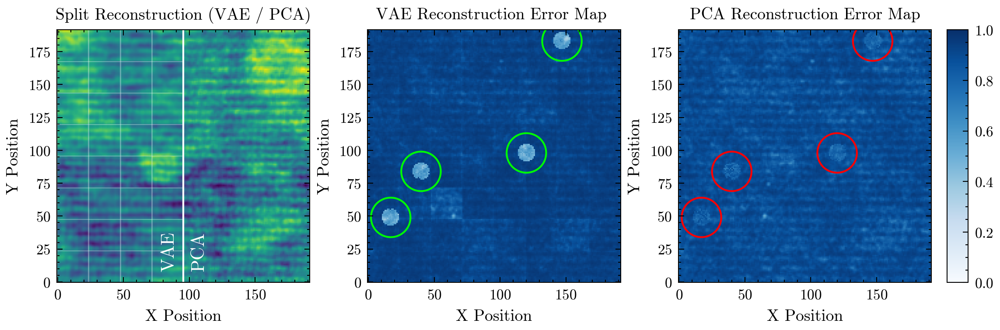

In [7]:
import matplotlib.pyplot as plt
import scienceplots
import numpy as np
from matplotlib.gridspec import GridSpec
from matplotlib.patches import Circle
from scipy import ndimage

def plot_eels_comparison(split_map, vae_pcc, pca_pcc, anomaly_mask, save_path=None, dpi=300):
    """
    Plot EELS comparison heatmaps with matplotlib
    Args:
        split_map: numpy array of the split VAE/PCA reconstruction
        vae_pcc: numpy array of VAE PCC scores
        pca_pcc: numpy array of PCA PCC scores
        anomaly_mask: boolean array indicating anomaly locations
        save_path: optional path to save the figure
        dpi: resolution for saved figure
    """
    # Set the style
    plt.style.use(['science', 'no-latex'])
    
    # Set font sizes
    plt.rcParams.update({
        'xtick.labelsize': 8,
        'ytick.labelsize': 8,
        'axes.titlesize': 9,
        'axes.labelsize': 9,
    })

    # Create figure with special gridspec to accommodate colorbar
    fig = plt.figure(figsize=(8, 3.5), dpi=dpi)
    
    # Create GridSpec with normal spacing for the main plots
    gs = GridSpec(1, 4, figure=fig, width_ratios=[1, 1, 1, 0.05])
    gs.update(wspace=0.3, left=0.05, right=0.95, top=0.9, bottom=0.15)

    # Create subplots
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])
    ax3 = fig.add_subplot(gs[0, 2])
    cax = fig.add_subplot(gs[0, 3])  # Subplot for colorbar

    # Plot split reconstruction with flipped y-axis
    im1 = ax1.imshow(split_map, cmap='viridis', aspect='equal', origin='lower')
    ax1.set_title('Split Reconstruction (VAE / PCA)')
    ax1.set_xlabel('X Position')
    ax1.set_ylabel('Y Position')

    # Add vertical line in the middle of the first plot
    x_mid = split_map.shape[1] // 2
    ax1.axvline(x=x_mid - 0.5, color='white', linestyle='-', linewidth=1)

    # Add VAE and PCA labels vertically aligned with the dividing line
    ax1.text(x_mid - 5, 38, 'VAE', 
             rotation=90, verticalalignment='top', 
             horizontalalignment='right', color='white', 
             fontsize=10)
    ax1.text(x_mid + 5, 38, 'PCA', 
             rotation=90, verticalalignment='top', 
             horizontalalignment='left', color='white', 
             fontsize=10)

    # Add 24x24 grid overlay on VAE side only
    for x in range(0, x_mid, 24):
        ax1.axvline(x=x - 0.5, color='white', linestyle='-', linewidth=0.75, alpha=0.3)

    # Add final vertical line at x_mid if it doesn't align with the grid
    if x_mid % 24 != 0:
        ax1.axvline(x=x_mid - 0.5, color='white', linestyle='-', linewidth=0.75, alpha=0.3)
    
    # Horizontal grid lines for full height of VAE section
    for y in range(0, split_map.shape[0] + 1, 24):
        ax1.plot([0 - 0.5, x_mid - 0.5], [y - 0.5, y - 0.5], 
                 color='white', linestyle='-', linewidth=0.5, alpha=0.3)

    # Plot VAE PCC with flipped y-axis
    im2 = ax2.imshow(vae_pcc, cmap='Blues', aspect='equal', vmin=0, vmax=1, origin='lower')
    ax2.set_title('VAE Reconstruction Error Map ')
    ax2.set_xlabel('X Position')
    ax2.set_ylabel('Y Position')

    # Plot PCA PCC with flipped y-axis
    im3 = ax3.imshow(pca_pcc, cmap='Blues', aspect='equal', vmin=0, vmax=1, origin='lower')
    ax3.set_title('PCA Reconstruction Error Map')
    ax3.set_xlabel('X Position')
    ax3.set_ylabel('Y Position')

    # Find the centers of the anomaly regions
    labeled_mask, num_features = ndimage.label(anomaly_mask)
    centers = ndimage.center_of_mass(anomaly_mask, labeled_mask, range(1, num_features + 1))
    
    # Add circles around anomaly centers on both VAE and PCA plots
    for center in centers:
        # Green circle for VAE plot
        circle_vae = Circle((center[1], center[0]), radius=15, fill=False, color='lime', linewidth=1)
        ax2.add_patch(circle_vae)
        
        # Red circle for PCA plot
        circle_pca = Circle((center[1], center[0]), radius=15, fill=False, color='red', linewidth=1)
        ax3.add_patch(circle_pca)

    # Add colorbar with matching height
    plt.colorbar(im3, cax=cax, extend='neither')
    
    # Get the position of the last plot (ax3)
    pos3 = ax3.get_position()
    
    # Calculate new colorbar position with reduced spacing
    colorbar_width = 0.02  # Width of colorbar
    spacing = 0.015  # Reduced spacing between plot and colorbar
    
    # Set colorbar position: right after the last plot with minimal spacing
    cax.set_position([
        pos3.x1 + spacing,  # X position: right edge of last plot + small space
        pos3.y0,           # Match bottom of plot
        colorbar_width,    # Width of colorbar
        pos3.height        # Match height of plot
    ])

    # Save the figure if path is provided
    if save_path:
        ext = save_path.split('.')[-1].lower()
        save_kwargs = {
            'bbox_inches': 'tight',
            'pad_inches': 0.02,
        }
        
        if ext in ['png', 'tiff']:
            save_kwargs.update({
                'dpi': dpi,
                'transparent': True,
            })
        elif ext == 'pdf':
            save_kwargs.update({
                'metadata': {'Creator': 'Matplotlib', 'Title': 'Precision-Recall Analysis'}
            })
        elif ext == 'eps':
            save_kwargs.update({
                'transparent': True
            })
            
        fig.savefig(save_path, **save_kwargs)
        print(f"Figure saved as {save_path}")

    return fig

# Updated function call to include anomaly_mask
fig = plot_eels_comparison(
    split_map=split_map,
    vae_pcc=vae_pcc,
    pca_pcc=pca_pcc,
    anomaly_mask=anomaly_mask,
    save_path="3_heatmaps.png"
)
plt.show()

In [9]:
import numpy as np
import torch
from tqdm import tqdm
import umap
from dash import Dash, html, dcc
from dash.dependencies import Input, Output
import plotly.graph_objects as go
from dash.exceptions import PreventUpdate
import base64
from io import BytesIO
from PIL import Image
import plotly.express as px

def np_image_to_base64(image_np):
    """Convert numpy image to base64 string"""
    img = Image.fromarray(image_np)
    buffer = BytesIO()
    img.save(buffer, format="PNG")
    encoded_image = base64.b64encode(buffer.getvalue()).decode()
    return f"data:image/png;base64,{encoded_image}"

def get_latent_representations(data, model, device, shard_size=24):
    """
    Get latent space representations for the data
    """
    # First adjust energy dimension
    adjusted_data = adjust_energy_dimension(data)
    
    # Split into shards
    shards, positions = split_into_shards(adjusted_data, shard_size)
    latent_vectors = []
    
    print("Processing data through VAE encoder...")
    with torch.no_grad():
        for shard in tqdm(shards):
            # Process through VAE encoder
            shard_tensor = torch.tensor(shard).unsqueeze(0).unsqueeze(0).float().to(device)
            mean, _ = model.encode(shard_tensor)
            latent_vectors.append(mean.cpu().numpy())
    
    return np.vstack(latent_vectors), positions

def create_latent_space_visualization(normal_data, anomalous_data, model, device, 
                                    n_components=3, n_neighbors=15, min_dist=0.1):
    """
    Create UMAP visualization of latent space
    """
    # Get latent representations
    print("Processing normal data...")
    normal_latents, normal_positions = get_latent_representations(normal_data, model, device)
    
    print("Processing anomalous data...")
    anomalous_latents, anomalous_positions = get_latent_representations(anomalous_data, model, device)
    
    # Combine latent vectors and create labels
    all_latents = np.vstack([normal_latents, anomalous_latents])
    labels = np.array(['Normal'] * len(normal_latents) + ['Anomalous'] * len(anomalous_latents))
    
    # Apply UMAP
    print("Applying UMAP...")
    reducer = umap.UMAP(n_components=n_components, n_neighbors=n_neighbors, min_dist=min_dist)
    embeddings = reducer.fit_transform(all_latents)
    
    # Create visualization
    if n_components == 3:
        fig = go.Figure(data=[
            go.Scatter3d(
                x=embeddings[labels == 'Normal', 0],
                y=embeddings[labels == 'Normal', 1],
                z=embeddings[labels == 'Normal', 2],
                mode='markers',
                name='Normal',
                marker=dict(
                    size=3,
                    color='blue',
                    opacity=0.8
                )
            ),
            go.Scatter3d(
                x=embeddings[labels == 'Anomalous', 0],
                y=embeddings[labels == 'Anomalous', 1],
                z=embeddings[labels == 'Anomalous', 2],
                mode='markers',
                name='Anomalous',
                marker=dict(
                    size=3,
                    color='red',
                    opacity=0.8
                )
            )
        ])
        
        fig.update_layout(
            title="3D UMAP of VAE Latent Space",
            scene=dict(
                xaxis_title="UMAP 1",
                yaxis_title="UMAP 2",
                zaxis_title="UMAP 3",
            ),
        )
    else:
        fig = px.scatter(
            x=embeddings[:, 0],
            y=embeddings[:, 1],
            color=labels,
            color_discrete_map={'Normal': 'blue', 'Anomalous': 'red'},
            title="2D UMAP of VAE Latent Space"
        )
        
        fig.update_layout(
            xaxis_title="UMAP 1",
            yaxis_title="UMAP 2",
        )
    
    return fig, embeddings, labels, normal_positions, anomalous_positions

def create_interactive_visualization(embeddings, labels, normal_data, anomalous_data, 
                                  normal_positions, anomalous_positions):
    """
    Create interactive Dash visualization with fixed hover functionality
    """
    # Combine data
    all_data = np.vstack([normal_data, anomalous_data])
    all_positions = normal_positions + anomalous_positions
    
    # Check dimensionality
    n_dimensions = embeddings.shape[1]
    
    if n_dimensions == 3:
        traces = [
            go.Scatter3d(
                x=embeddings[labels == 'Normal', 0],
                y=embeddings[labels == 'Normal', 1],
                z=embeddings[labels == 'Normal', 2],
                mode='markers',
                name='Normal',
                marker=dict(size=3, color='blue', opacity=0.8),
                customdata=np.arange(len(embeddings))[labels == 'Normal'],
                hovertemplate="Point %{customdata}<extra></extra>"
            ),
            go.Scatter3d(
                x=embeddings[labels == 'Anomalous', 0],
                y=embeddings[labels == 'Anomalous', 1],
                z=embeddings[labels == 'Anomalous', 2],
                mode='markers',
                name='Anomalous',
                marker=dict(size=3, color='red', opacity=0.8),
                customdata=np.arange(len(embeddings))[labels == 'Anomalous'],
                hovertemplate="Point %{customdata}<extra></extra>"
            )
        ]
        layout = dict(
            title="3D UMAP of VAE Latent Space",
            scene=dict(
                xaxis_title="UMAP 1",
                yaxis_title="UMAP 2",
                zaxis_title="UMAP 3",
            )
        )
    else:
        traces = [
            go.Scatter(
                x=embeddings[labels == 'Normal', 0],
                y=embeddings[labels == 'Normal', 1],
                mode='markers',
                name='Normal',
                marker=dict(size=3, color='blue', opacity=0.8),
                customdata=np.arange(len(embeddings))[labels == 'Normal'],
                hovertemplate="Point %{customdata}<extra></extra>"
            ),
            go.Scatter(
                x=embeddings[labels == 'Anomalous', 0],
                y=embeddings[labels == 'Anomalous', 1],
                mode='markers',
                name='Anomalous',
                marker=dict(size=3, color='red', opacity=0.8),
                customdata=np.arange(len(embeddings))[labels == 'Anomalous'],
                hovertemplate="Point %{customdata}<extra></extra>"
            )
        ]
        layout = dict(
            title="2D UMAP of VAE Latent Space",
            xaxis_title="UMAP 1",
            yaxis_title="UMAP 2"
        )
    
    fig = go.Figure(data=traces, layout=layout)
    
    # Create Dash app
    app = Dash(__name__)
    
    app.layout = html.Div([
        dcc.Graph(id="graph-plot", figure=fig, clear_on_unhover=True),
        dcc.Tooltip(id="graph-tooltip", direction='bottom')
    ])
    
    @app.callback(
        Output("graph-tooltip", "show"),
        Output("graph-tooltip", "bbox"),
        Output("graph-tooltip", "children"),
        Input("graph-plot", "hoverData"),
        prevent_initial_call=True
    )
    def display_hover(hover_data):
        if hover_data is None:
            return False
        
        # Get point index from hover data
        pt = hover_data["points"][0]
        bbox = pt["bbox"]
        idx = int(pt["customdata"])
        
        try:
            # Get position info
            pos = all_positions[idx]
            
            # Extract and normalize shard
            shard = all_data[pos[0]:pos[0]+24, pos[1]:pos[1]+24]
            eels_data = np.sum(shard, axis=-1)
            eels_data = (eels_data - eels_data.min()) / (eels_data.max() - eels_data.min())
            eels_image = (eels_data * 255).astype(np.uint8)
            
            # Convert to base64
            im_url = np_image_to_base64(eels_image)
            
            # Create tooltip content
            children = [
                html.Div([
                    html.Img(
                        src=im_url,
                        style={
                            "width": "100px",
                            "display": "block",
                            "margin": "0 auto"
                        }
                    ),
                    html.P(
                        f"Type: {labels[idx]}",
                        style={
                            "textAlign": "center",
                            "margin": "5px"
                        }
                    ),
                    html.P(
                        f"Position: ({pos[0]}, {pos[1]})",
                        style={
                            "textAlign": "center",
                            "margin": "5px"
                        }
                    )
                ])
            ]
            
            return True, bbox, children
            
        except Exception as e:
            print(f"Error in hover callback: {str(e)}")
            return False
    
    return app

# Generate anomalous data
anomaly_specs = [
    ('peak_shift', 900, 1, {'shift_value': 13})
]
anomalous_data, _ = inject_controlled_anomalies(dataset, anomaly_specs)

# Create visualization (for 2D)
fig, embeddings, labels, normal_positions, anomalous_positions = create_latent_space_visualization(
    normal_data=dataset,
    anomalous_data=anomalous_data,
    model=model,
    device=device,
    n_components=3  # Specify 2 components
)

# Create interactive visualization
app = create_interactive_visualization(
    embeddings=embeddings,
    labels=labels,
    normal_data=dataset,
    anomalous_data=anomalous_data,
    normal_positions=normal_positions,
    anomalous_positions=anomalous_positions
)

# Run the app
app.run(jupyter_mode="external", jupyter_height=2000, jupyter_width="200%")

Processing normal data...
Original energy points: 1312
Adjusted energy points: 1312
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing data through VAE encoder...


100%|██████████| 64/64 [00:00<00:00, 65.80it/s]


Processing anomalous data...
Original energy points: 1312
Adjusted energy points: 1312
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing data through VAE encoder...


100%|██████████| 64/64 [00:00<00:00, 66.28it/s]


Applying UMAP...


Address already in use
Port 8050 is in use by another program. Either identify and stop that program, or start the server with a different port.


AttributeError: 'tuple' object has no attribute 'tb_frame'

Getting latent representations...
Original energy points: 1312
Adjusted energy points: 1312
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing data through VAE encoder...


  0%|          | 0/64 [00:00<?, ?it/s]

100%|██████████| 64/64 [00:00<00:00, 65.49it/s]


Original energy points: 1312
Adjusted energy points: 1312
Will create 64 complete shards of size 24x24
Individual shard shape: (24, 24, 1312)
Number of shards created: 64
Processing data through VAE encoder...


100%|██████████| 64/64 [00:00<00:00, 65.64it/s]


Figure saved as latent_heatmap.png


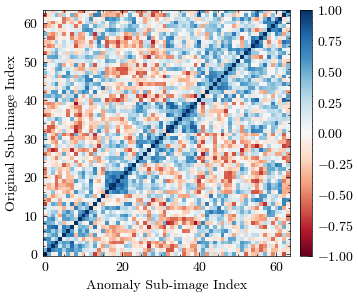

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scienceplots
from sklearn.metrics.pairwise import cosine_similarity
from mpl_toolkits.axes_grid1 import make_axes_locatable

def create_publication_similarity_viz(normal_latents, anomalous_latents, normal_positions, anomalous_positions, save_path=None):
    """
    Create publication-ready visualization with matched colorbar size and no grid
    """
    # Map positions and create similarity matrix (same as before)
    position_to_idx = {}
    normal_idx_map = {}
    anomaly_idx_map = {}
    
    for idx, pos in enumerate(normal_positions):
        pos_tuple = (pos[0], pos[1])
        position_to_idx[pos_tuple] = idx
        normal_idx_map[pos_tuple] = idx
        
    for idx, pos in enumerate(anomalous_positions):
        pos_tuple = (pos[0], pos[1])
        anomaly_idx_map[pos_tuple] = idx
    
    common_positions = sorted(set(normal_idx_map.keys()) & set(anomaly_idx_map.keys()))
    
    paired_normal = []
    paired_anomaly = []
    
    for pos in common_positions:
        normal_idx = normal_idx_map[pos]
        anomaly_idx = anomaly_idx_map[pos]
        paired_normal.append(normal_latents[normal_idx])
        paired_anomaly.append(anomalous_latents[anomaly_idx])
    
    paired_normal = np.array(paired_normal)
    paired_anomaly = np.array(paired_anomaly)
    
    similarity_matrix = cosine_similarity(paired_normal, paired_anomaly)
    
    # Create plot with science style but without grid
    plt.style.use(['science', 'no-latex', 'grid'])
    
    # Create figure with specific size
    fig, ax = plt.subplots(figsize=(3.5, 3.2))

    # Explicitly turn off all grid lines
    ax.grid(False)
    ax.set_axisbelow(False)
    
    # Create divider for exact colorbar size matching
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    
    # Create heatmap
    im = ax.imshow(similarity_matrix, cmap='RdBu', aspect='equal', 
                   vmin=-1, vmax=1, origin='lower')
    
    # Add colorbar with matched size
    cbar = plt.colorbar(im, cax=cax)
    
    # # Set ticks
    # n_samples = len(similarity_matrix)
    # tick_step = max(1, n_samples // 10)
    # ticks = np.arange(0, n_samples, tick_step)
    
    # ax.set_xticks(ticks)
    # ax.set_yticks(ticks)
    # ax.set_xticklabels(ticks + 1)
    # ax.set_yticklabels(ticks + 1)
    
    # Labels
    ax.set_xlabel('Anomaly Sub-image Index')
    ax.set_ylabel('Original Sub-image Index')
    
    # plt.tight_layout()

    # Save the figure if path is provided
    if save_path:
        ext = save_path.split('.')[-1].lower()
        save_kwargs = {
            'bbox_inches': 'tight',
            'pad_inches': 0.02,
        }
        
        if ext in ['png', 'tiff']:
            save_kwargs.update({
                'dpi': 300,
                'transparent': True,
            })
        elif ext == 'pdf':
            save_kwargs.update({
                'metadata': {'Creator': 'Matplotlib', 'Title': 'Precision-Recall Analysis'}
            })
        elif ext == 'eps':
            save_kwargs.update({
                'transparent': True
            })
            
        fig.savefig(save_path, **save_kwargs)
        print(f"Figure saved as {save_path}")
    
    return fig, similarity_matrix, common_positions

# Get latent representations
print("Getting latent representations...")
normal_latents, normal_positions = get_latent_representations(dataset, model, device)
anomalous_latents, anomalous_positions = get_latent_representations(anomalous_data, model, device)

# Create visualization
fig, similarity_matrix, positions_list = create_publication_similarity_viz(
    normal_latents, 
    anomalous_latents, 
    normal_positions, 
    anomalous_positions,
    save_path="latent_heatmap.png"
)

# Show plot
plt.show()

# Save with high resolution
# plt.savefig('similarity_matrix.pdf', dpi=300, bbox_inches='tight')


Directional Analysis Results:

Magnitude Statistics:
Mean ± Std: 0.048 ± 0.015

Angular Statistics:
Mean Angle Deviation: 50.32°
Angle Std Deviation: 14.79°
Direction Consistency: 0.618

PCA Explained Variance Ratios:
First two components explain 44.2% of variance
Component 1: 26.8%
Component 2: 17.4%


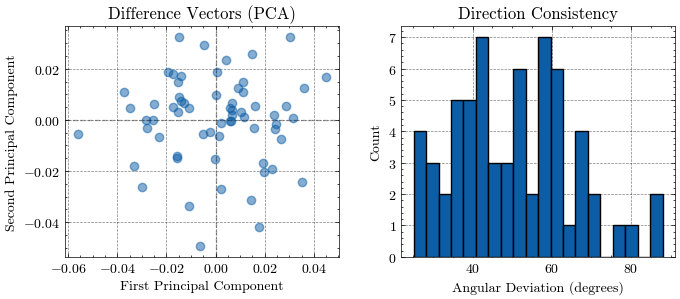

In [41]:
import numpy as np
from scipy.spatial.distance import euclidean, cosine
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import seaborn as sns

def analyze_embedding_directions(normal_latents, anomalous_latents, normal_positions, anomalous_positions):
    """
    Analyze the directional consistency of the shift from normal to anomalous embeddings
    """
    # Create position mapping
    normal_idx_map = {(pos[0], pos[1]): idx for idx, pos in enumerate(normal_positions)}
    anomaly_idx_map = {(pos[0], pos[1]): idx for idx, pos in enumerate(anomalous_positions)}
    
    # Find common positions and create paired vectors
    common_positions = sorted(set(normal_idx_map.keys()) & set(anomaly_idx_map.keys()))
    
    # Calculate difference vectors (anomalous - normal)
    difference_vectors = []
    magnitudes = []
    
    for pos in common_positions:
        normal_idx = normal_idx_map[pos]
        anomaly_idx = anomaly_idx_map[pos]
        
        normal_embedding = normal_latents[normal_idx]
        anomaly_embedding = anomalous_latents[anomaly_idx]
        
        # Calculate difference vector
        diff_vector = anomaly_embedding - normal_embedding
        difference_vectors.append(diff_vector)
        
        # Calculate magnitude
        magnitude = np.linalg.norm(diff_vector)
        magnitudes.append(magnitude)
    
    difference_vectors = np.array(difference_vectors)
    magnitudes = np.array(magnitudes)
    
    # Calculate average direction vector
    average_direction = np.mean(difference_vectors, axis=0)
    average_direction_norm = average_direction / np.linalg.norm(average_direction)
    
    # Calculate consistency metrics
    cosine_similarities = []
    for diff_vector in difference_vectors:
        normalized_vector = diff_vector / np.linalg.norm(diff_vector)
        cos_sim = np.dot(normalized_vector, average_direction_norm)
        cosine_similarities.append(cos_sim)
    
    cosine_similarities = np.array(cosine_similarities)
    
    # Calculate angular deviation (in degrees)
    angles = np.arccos(np.clip(cosine_similarities, -1.0, 1.0)) * 180.0 / np.pi
    
    # Perform PCA for visualization
    pca = PCA(n_components=2)
    diff_vectors_2d = pca.fit_transform(difference_vectors)
    
    # Create visualization
    plt.style.use(['science', 'no-latex'])
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3.2))
    
    # Plot 1: Difference vectors in 2D PCA space
    ax1.scatter(diff_vectors_2d[:, 0], diff_vectors_2d[:, 1], alpha=0.5)
    ax1.axhline(y=0, color='k', linestyle='--', alpha=0.3)
    ax1.axvline(x=0, color='k', linestyle='--', alpha=0.3)
    ax1.set_xlabel('First Principal Component')
    ax1.set_ylabel('Second Principal Component')
    ax1.set_title('Difference Vectors (PCA)')
    
    # Plot 2: Angular deviation histogram
    ax2.hist(angles, bins=20, edgecolor='black')
    ax2.set_xlabel('Angular Deviation (degrees)')
    ax2.set_ylabel('Count')
    ax2.set_title('Direction Consistency')
    
    plt.tight_layout()
    
    # Calculate statistics
    stats = {
        'mean_magnitude': np.mean(magnitudes),
        'std_magnitude': np.std(magnitudes),
        'mean_angle': np.mean(angles),
        'std_angle': np.std(angles),
        'direction_consistency': np.mean(cosine_similarities),
        'explained_variance_ratio': pca.explained_variance_ratio_
    }
    
    return stats, {
        'difference_vectors': difference_vectors,
        'magnitudes': magnitudes,
        'angles': angles,
        'average_direction': average_direction,
        'pca_components': diff_vectors_2d,
        'cosine_similarities': cosine_similarities
    }

# Run analysis
stats, data = analyze_embedding_directions(normal_latents, anomalous_latents, normal_positions, anomalous_positions)

# Print results
print("\nDirectional Analysis Results:")
print(f"\nMagnitude Statistics:")
print(f"Mean ± Std: {stats['mean_magnitude']:.3f} ± {stats['std_magnitude']:.3f}")

print(f"\nAngular Statistics:")
print(f"Mean Angle Deviation: {stats['mean_angle']:.2f}°")
print(f"Angle Std Deviation: {stats['std_angle']:.2f}°")
print(f"Direction Consistency: {stats['direction_consistency']:.3f}")

print(f"\nPCA Explained Variance Ratios:")
print(f"First two components explain {sum(stats['explained_variance_ratio'])*100:.1f}% of variance")
print(f"Component 1: {stats['explained_variance_ratio'][0]*100:.1f}%")
print(f"Component 2: {stats['explained_variance_ratio'][1]*100:.1f}%")

# Show plot
plt.show()

These results tell us something very interesting about how VAE is encoding the anomalies:

1. Magnitude Analysis:
- Mean magnitude of 0.048 ± 0.015 shows the shifts are relatively small and consistent in size
- The low standard deviation (about 31% of the mean) indicates the "distance" of the shift is fairly consistent

2. Directional Analysis:
- Mean angle deviation of 50.32° ± 14.79° is quite significant
- This indicates the direction of shift is NOT consistent across different samples
- A direction consistency of 0.618 (where 1.0 would be perfect alignment) confirms moderate but not strong directional consistency

3. PCA Results:
- Only 44.2% of variance explained by first two components is quite low
- 26.8% for first component and 17.4% for second suggests the shifts are happening in many dimensions
- This indicates the transformations are not confined to a simple plane or direction

Interpretation:
1. The VAE is moving embeddings by a consistent amount (0.048 units) when encoding anomalies
2. However, the direction of this movement varies significantly (50° average deviation)
3. The transformations are happening in high-dimensional space (low PCA explained variance)

This suggests that:
- VAE isn't learning a simple "shift" operation for anomalies
- Instead, it's learning more complex transformations that:
  - Maintain consistent magnitude
  - But vary in direction based on perhaps the local context or specific features of each sub-image
- The anomaly encoding might be feature-dependent rather than following a global pattern

In [9]:
# SINGLE PCC PIXEL DISTRIBUTION HISTOGRAM 
def plot_pcc_distributions(vae_pcc, pca_pcc, anomaly_mask, save_path=None):
    """
    Create histogram plot comparing PCC distributions for VAE and PCA with auto-positioned elements
    """
    # Separate normal and anomalous pixels
    vae_normal = vae_pcc[anomaly_mask == 0].flatten()
    vae_anomaly = vae_pcc[anomaly_mask > 0].flatten()
    pca_normal = pca_pcc[anomaly_mask == 0].flatten()
    pca_anomaly = pca_pcc[anomaly_mask > 0].flatten()
    
    # Create figure
    fig = go.Figure()
    
    # Define datasets with their properties
    datasets = [
        (vae_normal, 'VAE - Normal', 'rgba(99, 110, 250, 0.7)'),
        (vae_anomaly, 'VAE - Anomaly', 'rgba(239, 85, 59, 0.7)'),
        (pca_normal, 'PCA - Normal', 'rgba(0, 204, 150, 0.7)'),
        (pca_anomaly, 'PCA - Anomaly', 'rgba(255, 161, 90, 0.7)')
    ]
    
    # Add histograms
    for data, name, color in datasets:
        fig.add_trace(go.Histogram(
            x=data,
            name=name,
            opacity=0.75,
            nbinsx=50,
            marker_color=color
        ))
        
        # Add mean line
        mean_val = np.mean(data)
        fig.add_vline(
            x=mean_val,
            line_dash="dash",
            line_color=color.replace('0.7', '1'),
            annotation_text=f"{name}<br>Mean: {mean_val:.3f}",
            annotation={
                'textangle': 90,  # Rotate text 90 degrees
            }
        )
    
    # Update layout
    fig.update_layout(
        title='PCC Score Distribution Comparison',
        xaxis_title='Pearson Correlation Coefficient',
        yaxis_title='Count',
        barmode='overlay',
        width=1200,
        height=800,
        xaxis=dict(
            # range=[0, 1],
            dtick=0.05
        ),
        yaxis=dict(
            tickfont=dict(size=12), 
            autorange=True,
            autoshift=True,
            type="-",
            title_text='Count (log scale)'  # Update label to indicate scaling
        ),
        plot_bgcolor='white',
        legend=dict(
            x=0,
            y=1,
            xanchor='left',
            yanchor='top',
            bgcolor='rgba(255, 255, 255, 0.8)'  # Semi-transparent background
        )
    )

    # Save if path provided
    if save_path:
        fig.write_image(save_path + "_distributions.png", scale=2)
        print(f"Distribution plots saved as {save_path}_distributions.html and {save_path}_distributions.png")
    
    return fig

# Assuming you have your PCC maps and anomaly mask
fig = plot_pcc_distributions(
    vae_pcc=vae_pcc,
    pca_pcc=pca_pcc,
    anomaly_mask=anomaly_mask,
    save_path="pcc_comparison"
)

fig.show()

Distribution plots saved as pcc_comparison_distributions.html and pcc_comparison_distributions.png


In [10]:
# DOUBLE PCC PIXEL PLOT DISTRIBUTION HISTOGRAM
def plot_pcc_distributions(vae_pcc, pca_pcc, anomaly_mask, save_path=None):
    """
    Create two stacked histogram plots with bar outlines and trendlines
    """
    # Separate normal and anomalous pixels
    vae_normal = vae_pcc[anomaly_mask == 0].flatten()
    vae_anomaly = vae_pcc[anomaly_mask > 0].flatten()
    pca_normal = pca_pcc[anomaly_mask == 0].flatten()
    pca_anomaly = pca_pcc[anomaly_mask > 0].flatten()
    
    # Create figure with secondary y-axis
    fig = make_subplots(
        rows=2, cols=1, 
        shared_xaxes=True,
        vertical_spacing=0.02
    )
    
    # Add VAE histograms and trendlines (top plot)
    # Normal pixels
    fig.add_trace(
        go.Histogram(
            x=vae_normal,
            name='VAE - Normal Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.01),
            autobinx=False,
            marker_color='rgba(99, 110, 250, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="vae",
            legendgrouptitle=dict(text="VAE", font=dict(size=19)),  # Increase VAE group title font size
        ),
        row=1, col=1
    )
    
    # Anomalous pixels
    fig.add_trace(
        go.Histogram(
            x=vae_anomaly,
            name='VAE - Anomaly Injected Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.01),
            autobinx=False,
            marker_color='rgba(239, 85, 59, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="vae"
        ),
        row=1, col=1
    )
    
    # Add PCA histograms and trendlines (bottom plot)
    # Normal pixels
    fig.add_trace(
        go.Histogram(
            x=pca_normal,
            name='PCA - Normal Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.01),
            autobinx=False,
            marker_color='rgba(0, 204, 150, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="pca",
            legendgrouptitle=dict(text="PCA", font=dict(size=19)),  # Increase VAE group title font size
            showlegend=True
        ),
        row=2, col=1
    )
    
    # Anomalous pixels
    fig.add_trace(
        go.Histogram(
            x=pca_anomaly,
            name='PCA - Anomaly Injected Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.01),
            autobinx=False,
            marker_color='rgba(255, 161, 90, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="pca",
            showlegend=True
        ),
        row=2, col=1
    )
    
    # Add mean lines and reference lines
    for i, (data, name, color) in enumerate([
        (vae_normal, 'VAE - Normal Pixels', 'rgba(99, 110, 250, 1.0)'),
        (vae_anomaly, 'VAE - Anomalous Pixels', 'rgba(239, 85, 59, 1.0)'),
        (pca_normal, 'PCA - Normal Pixels', 'rgba(0, 204, 150, 1.0)'),
        (pca_anomaly, 'PCA - Anomalous Pixels', 'rgba(255, 161, 90, 1.0)')
    ]):
        mean_val = np.mean(data)
        row = 1 if i < 2 else 2  # First two traces go to row 1, others to row 2
        
        # Add mean line
        fig.add_vline(
            x=mean_val,
            line_dash="dash",
            line_color=color,
            annotation={
                'text': f"  Mean: {mean_val:.3f}",
                'xshift': -125,
                # 'textangle': 90,
                # 'yanchor': 'bottom',
                # 'y': 1.1,
                # 'xanchor': 'left',
                'font': {'size': 16} 
            },
            row=row, col=1
        )
    
    # Add vertical reference lines
    for x_val in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]:
        for row in [1, 2]:
            fig.add_vline(
                x=x_val,
                line_color='rgba(128, 128, 128, 0.2)',
                line_width=1,
                row=row, col=1
            )
    
    # Update layout
    fig.update_layout(
        # title='PCC Score Distribution Comparison',
        barmode='overlay',
        width=1200,
        height=1000,
        # Split legend into two columns
        legend=dict(
            x=0.06,
            y=0.22,  # Move legend above plots
            xanchor='left',
            yanchor='bottom',
            bgcolor='rgba(255, 255, 255, 0.8)',
            bordercolor='black',
            borderwidth=1,
            traceorder='grouped',  # Group by VAE/PCA
            font=dict(size=18), 
        ),
        plot_bgcolor='white'
    )
    
    # Update x-axes
    fig.update_xaxes(
        title_text='Pearson Correlation Coefficient (690 - 730 eV Region)',
        # range=[0, 1],
        dtick=0.1,
        title_font=dict(size=18),  # Larger x-axis title font size
        tickfont=dict(size=18),
        row=2, col=1  # Only show x-axis title on bottom plot
    )
    
    # Update y-axes
    for row in [1, 2]:
        fig.update_yaxes(
            title_text='SI Pixel Count (log scale)',
            type='log',
            title_font=dict(size=18),  # Larger x-axis title font size
            tickfont=dict(size=18),
            nticks=10,
            # tickformat='d',
            gridwidth=1,
            gridcolor='rgba(128, 128, 128, 0.2)',
            row=row, col=1
        )
    
    # Save if path provided
    if save_path:
        fig.write_image("histogram_main.png", scale=2)
    
    return fig

# Assuming you have your PCC maps and anomaly mask
fig = plot_pcc_distributions(
    vae_pcc=vae_pcc,
    pca_pcc=pca_pcc,
    anomaly_mask=anomaly_mask,
    save_path=""
)

fig.show()


In [87]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import scienceplots

def plot_pcc_distributions(vae_pcc, pca_pcc, anomaly_mask, save_path=None):
    """
    Create two stacked histogram plots with bar outlines and trendlines using science style
    """
    # Set style globally for consistent fonts
    plt.style.use(['science', 'no-latex'])
    
    # Get the font family from science style
    font_family = plt.rcParams['font.family'][0]
    
    # Separate normal and anomalous pixels
    vae_normal = vae_pcc[anomaly_mask == 0].flatten()
    vae_anomaly = vae_pcc[anomaly_mask > 0].flatten()
    pca_normal = pca_pcc[anomaly_mask == 0].flatten()
    pca_anomaly = pca_pcc[anomaly_mask > 0].flatten()
    
    # Create figure with secondary y-axis
    fig = make_subplots(
        rows=2, cols=1, 
        shared_xaxes=True,
        vertical_spacing=0.02,
    )
    
    # [Previous histogram traces remain the same until the mean lines section]
    
    # Add VAE histograms
    fig.add_trace(
        go.Histogram(
            x=vae_normal,
            name='VAE - Normal Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.013),
            autobinx=False,
            marker_color='rgba(99, 110, 250, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="vae",
            legendgrouptitle=dict(
                text="VAE", 
                font=dict(size=17, family=font_family)
            ),
        ),
        row=1, col=1
    )
    
    fig.add_trace(
        go.Histogram(
            x=vae_anomaly,
            name='VAE - Anomaly Injected Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.013),
            autobinx=False,
            marker_color='rgba(239, 85, 59, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="vae"
        ),
        row=1, col=1
    )
    
    # Add PCA histograms
    fig.add_trace(
        go.Histogram(
            x=pca_normal,
            name='PCA - Normal Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.013),
            autobinx=False,
            marker_color='rgba(0, 204, 150, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="pca",
            legendgrouptitle=dict(
                text="PCA", 
                font=dict(size=17, family=font_family)
            ),
            showlegend=True
        ),
        row=2, col=1
    )
    
    fig.add_trace(
        go.Histogram(
            x=pca_anomaly,
            name='PCA - Anomaly Injected Pixels',
            opacity=0.75,
            xbins=dict(start=0, end=1, size=0.013),
            autobinx=False,
            marker_color='rgba(255, 161, 90, 0.7)',
            marker_line_color='black',
            marker_line_width=1,
            legendgroup="pca",
            showlegend=True
        ),
        row=2, col=1
    )
    
    # Add mean lines with adjusted y-positions for annotations
    mean_data = [
        (vae_normal, 'VAE - Normal Pixels', 'rgba(99, 110, 250, 1.0)', 1, -150),
        (vae_anomaly, 'VAE - Anomalous Pixels', 'rgba(239, 85, 59, 1.0)', 1, -150),
        (pca_normal, 'PCA - Normal Pixels', 'rgba(0, 204, 150, 1.0)', 2, -150),
        (pca_anomaly, 'PCA - Anomalous Pixels', 'rgba(255, 161, 90, 1.0)', 2, -150, 'bottom')
    ]
    
    for data_info in mean_data:
        data = data_info[0]
        color = data_info[2]
        row = data_info[3]
        xshift = data_info[4]
        
        mean_val = np.mean(data)
        
        # Special handling for PCA anomaly mean label
        if len(data_info) > 5 and data_info[5] == 'bottom':
            # Position the PCA anomaly mean label lower
            annotation = {
                'text': f"  Mean: {mean_val:.3f}",
                'xshift': xshift,
                'yshift': -40,  # Move label down
                'font': {
                    'size': 20,
                    'family': font_family,
                    'color': 'black'  # Add this
                },
                'yanchor': 'top'  # Anchor to top so yshift moves it down
            }
        else:
            annotation = {
                'text': f"  Mean: {mean_val:.3f}",
                'yshift': 5,  # Move label down
                'xshift': xshift,
                'font': {
                    'size': 20,
                    'family': font_family,
                    'color': 'black'  # Add this
                }
            }
        
        fig.add_vline(
            x=mean_val,
            line_dash="dash",
            line_color=color,
            annotation=annotation,
            row=row, col=1
        )
    
    # Add vertical reference lines
    for x_val in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]:
        for row in [1, 2]:
            fig.add_vline(
                x=x_val,
                line_color='rgba(128, 128, 128, 0.2)',
                line_width=1,
                row=row, col=1
            )
    
    # Update layout with reduced margins
    fig.update_layout(
        barmode='overlay',
        width=700,
        height=700,
        margin=dict(
            l=80,   # left margin
            r=30,   # right margin
            t=30,   # top margin
            b=80    # bottom margin
        ),
        legend=dict(
            x=0.018,
            y=0.2,
            xanchor='left',
            yanchor='bottom',
            bgcolor='rgba(255, 255, 255, 0.8)',
            bordercolor='black',
            borderwidth=1,
            traceorder='grouped',
            font=dict(
                size=15,
                family=font_family,
                color='black'  # Add this
            ),
        ),
        plot_bgcolor='white',
        font=dict(
            family=font_family,
            size=20,
            color='black'  # Add this
        )
    )
    
    # Update x-axis
    fig.update_xaxes(
        title_text='Pearson Correlation Coefficient (690 - 730 eV Region)',
        dtick=0.1,
        range=[0.21, 0.99],  # Add this line
        title_font=dict(
            size=22,
            family=font_family,
            color='black'  # Add this
        ),
        tickfont=dict(
            size=20,
            family=font_family,
            color='black'  # Add this
        ),
        row=2, col=1
    )
    
    # Add a single centered y-axis title
    fig.add_annotation(
        text='SI Pixel Count (log scale)',
        textangle=-90,
        x=-0.15,
        y=0.5,
        xref='paper',
        yref='paper',
        showarrow=False,
        font=dict(
            size=22,
            family=font_family,
            color='black'  # Add this
        )
    )
    
    # Update y-axes without titles
    for row in [1, 2]:
        fig.update_yaxes(
            title_text='',
            type='log',
            tickfont=dict(
                size=20,
                family=font_family,
                color='black'  # Add this
            ),
            nticks=10,
            gridwidth=1,
            gridcolor='rgba(128, 128, 128, 0.2)',
            row=row, col=1
        )
    
    # Save if path provided
    if save_path:
        fig.write_image(
            f"{save_path}.png",
            scale=5,  # Increases resolution (default is 1)
        )
        
    return fig

# Assuming you have your PCC maps and anomaly mask
fig = plot_pcc_distributions(
    vae_pcc=vae_pcc,
    pca_pcc=pca_pcc,
    anomaly_mask=anomaly_mask,
    save_path="double_histogram"
)

fig.show()

In [7]:
# ATTEMPTING TO GENERATE PLOTS FOR SHOWCASING THE ANOMALY DETECTION SUITE 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

energy_values = data.get_cropped_energy_values()

def plot_spectrum_transformation(original_spectrum, anomalous_spectrum, energy_range=None, title="Spectrum Transformation"):
    """
    Create a plot showing the transformation from original to anomalous spectrum
    
    Args:
        original_spectrum: numpy array of the original spectrum
        anomalous_spectrum: numpy array of the spectrum after anomaly injection
        energy_range: optional array of energy values for x-axis
        title: plot title
    """
    # Create x-axis values if not provided
    if energy_range is None:
        energy_range = np.arange(len(original_spectrum))
    
    # Create figure with secondary y-axis
    fig = make_subplots(
        rows=2,
        cols=1,
        vertical_spacing=0.2,
        subplot_titles=("Original Spectrum", "Anomaly Injected Spectrum")
    )
    
    # Add original spectrum trace
    fig.add_trace(
        go.Scatter(
            x=energy_range,
            y=original_spectrum,
            mode='lines',
            name='Original',
            line=dict(color='blue', width=2)
        ),
        row=1, col=1
    )
    
    # Add anomalous spectrum trace
    fig.add_trace(
        go.Scatter(
            x=energy_range,
            y=anomalous_spectrum,
            mode='lines',
            name='Anomalous',
            line=dict(color='red', width=2)
        ),
        row=2, col=1
    )
    
    # Add arrows to show transformation
    # Find significant changes to place arrows
    diff = np.abs(anomalous_spectrum - original_spectrum)
    arrow_points = np.where(diff > np.percentile(diff, 95))[0]  # Top 5% of changes
    
    # Select up to 5 well-spaced points for arrows
    if len(arrow_points) > 5:
        indices = np.linspace(0, len(arrow_points)-1, 5, dtype=int)
        arrow_points = arrow_points[indices]
    
    # Add arrows
    for point in arrow_points:
        fig.add_shape(
            type="line",
            x0=energy_range[point],
            y0=original_spectrum[point],
            x1=energy_range[point],
            y1=anomalous_spectrum[point],
            line=dict(
                color="gray",
                width=2,
                dash="dash"
            ),
            row=1,
            col=1
        )
        
        # Add arrowhead
        fig.add_annotation(
            x=energy_range[point],
            y=anomalous_spectrum[point],
            xref="x",
            yref="y",
            axref="x",
            ayref="y",
            ax=energy_range[point],
            ay=original_spectrum[point],
            arrowhead=2,
            arrowsize=1.5,
            arrowwidth=2,
            arrowcolor="gray",
            row=1,
            col=1
        )
    
    # Update layout
    fig.update_layout(
        title=title,
        showlegend=True,
        width=1000,
        height=800,
        template='simple_white'
    )
    
    # Update axes labels
    fig.update_xaxes(title_text="Energy Loss (eV)", row=1, col=1)
    fig.update_xaxes(title_text="Energy Loss (eV)", row=2, col=1)
    fig.update_yaxes(title_text="Intensity", row=1, col=1)
    fig.update_yaxes(title_text="Intensity", row=2, col=1)
    
    return fig

def plot_spectrum_with_shift_arrow(original_spectrum, anomalous_spectrum, energy_range=None, shift_value=2.5, title="Overlayed Spectrum with Shaded Differences and Shift Arrow"):
    """
    Plot overlay of original and anomalous spectrum with shaded difference areas and a shift arrow.
    
    Args:
        original_spectrum: numpy array of the original spectrum.
        anomalous_spectrum: numpy array of the spectrum after anomaly injection.
        energy_range: Optional array of energy values for x-axis.
        shift_value: Magnitude of energy shift to display.
        title: Plot title.
    """
    if energy_range is None:
        energy_range = np.arange(len(original_spectrum))
    
    # Calculate absolute differences to highlight significant changes
    diff = np.abs(anomalous_spectrum - original_spectrum)
    threshold = np.percentile(diff, 95)  # Highlight top 5% changes
    significant_diff = np.where(diff > threshold, diff, np.nan)

    # Create figure
    fig = go.Figure()

    # Plot original spectrum
    fig.add_trace(
        go.Scatter(
            x=energy_range, y=original_spectrum, mode='lines', 
            name='Original Spectrum', line=dict(color='blue', width=2)
        )
    )

    # Plot anomalous spectrum
    fig.add_trace(
        go.Scatter(
            x=energy_range, y=anomalous_spectrum, mode='lines', 
            name='Anomalous Spectrum', line=dict(color='red', width=2)
        )
    )

    # Shaded area for differences
    fig.add_trace(
        go.Scatter(
            x=np.concatenate([energy_range, energy_range[::-1]]), 
            y=np.concatenate([original_spectrum, anomalous_spectrum[::-1]]),
            fill='toself',
            fillcolor='rgba(255, 0, 0, 0.2)',
            line=dict(color='rgba(255, 0, 0, 0)'),
            hoverinfo='skip',
            showlegend=False,
            name='Difference Region'
        )
    )

    # Add tooltips for significant differences
    for idx in np.where(~np.isnan(significant_diff))[0]:
        fig.add_trace(
            go.Scatter(
                x=[energy_range[idx]], y=[original_spectrum[idx]], mode='markers',
                marker=dict(size=5, color='gray'),
                name=f'Diff at {energy_range[idx]} eV',
                hovertext=f'Diff: {significant_diff[idx]:.2f}',
                showlegend=False
            )
        )

    # Add shift arrow
    midpoint_x = np.median(energy_range)
    fig.add_annotation(
        x=midpoint_x + shift_value / 2, y=-0.05 * max(original_spectrum),
        ax=midpoint_x - shift_value / 2, ay=-0.05 * max(original_spectrum),
        xref="x", yref="y", axref="x", ayref="y",
        text=f"{shift_value} eV",
        showarrow=True, arrowhead=2, arrowsize=1.5, arrowwidth=2, arrowcolor="black",
        font=dict(size=12, color="black"), align="center"
    )

    # Update layout
    fig.update_layout(
        title=title, width=1000, height=600, template='simple_white',
        showlegend=True
    )
    fig.update_xaxes(title_text="Energy Loss (eV)")
    fig.update_yaxes(title_text="Intensity", range=[-0.1 * max(original_spectrum), max(anomalous_spectrum) * 1.1])

    return fig

# Generate anomalous data
anomaly_specs = [('peak_shift', 50, 1, {'shift_value': 8})]
anomalous_data, anomaly_mask = inject_controlled_anomalies(dataset, anomaly_specs)
anomaly_coords = np.argwhere(anomaly_mask > 0)
pixel_y, pixel_x = anomaly_coords[0]
original_spec = dataset[pixel_y, pixel_x]
anomalous_spec = anomalous_data[pixel_y, pixel_x]

# # Create the plot
# fig = plot_spectrum_transformation(
#     original_spectrum=original_spec,
#     anomalous_spectrum=anomalous_spec,
#     energy_range=energy_values,  # If you have energy values
#     title=f"Spectrum Transformation at Pixel ({pixel_y}, {pixel_x})"
# )

# Create the enhanced plot
fig = plot_spectrum_with_shift_arrow(
    original_spectrum=original_spec,
    anomalous_spectrum=anomalous_spec,
    energy_range=energy_values,
    title=f"Enhanced Spectrum Transformation at Pixel ({pixel_y}, {pixel_x})"
)

fig.show()

Figure saved as anomaly_plot.png


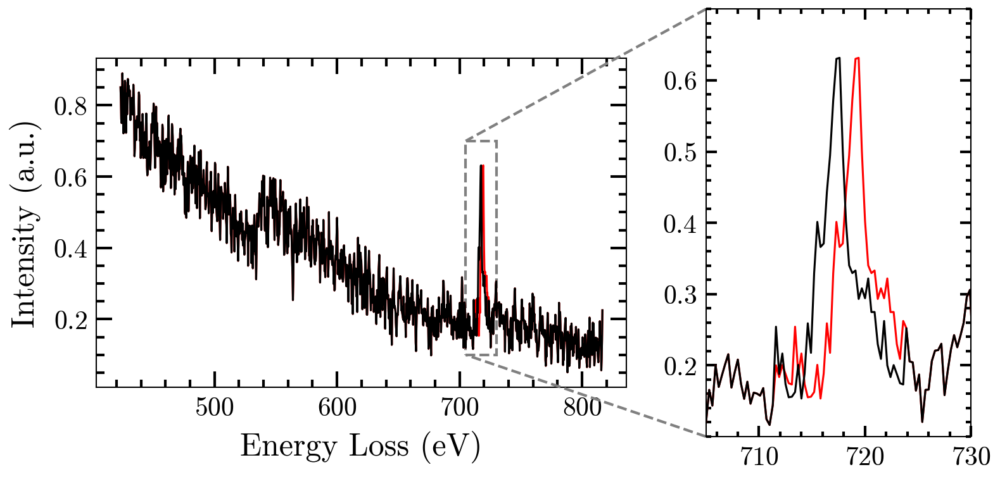

In [51]:
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset

def plot_random_spectrum_with_zoom(save_path=None):
    # # Set the style
    plt.style.use(['science', 'no-latex'])

    # Generate anomalous data
    anomaly_specs = [
        # ('peak_shift', 50, 1, {'shift_value': 6})
        ('peak_shift', 4, 6, {'shift_value': 6})
        # ('oxygen_deficiency', 5, 3, {'energy_range': energy_values,'deficiency_level': 0.3, 'ok_edge_start': 533})
    ]
    anomalous_data, anomaly_mask = inject_controlled_anomalies(dataset, anomaly_specs)

    loc = np.argwhere(anomaly_mask > 0)
    x, y = loc[0]

    # Create the figure
    fig, ax = plt.subplots(figsize=(3.6, 2.25), dpi=300)
    
    # Plot the spectrum
    ax.plot(energy_values, anomalous_data[x, y], 'r-', linewidth=0.75)
    ax.plot(energy_values, dataset[x, y], 'k-', linewidth=0.75)
    
    # Create zoomed inset axes with automatic positioning
    # axins = zoomed_inset_axes(ax, zoom=2.5, bbox_to_anchor=(1.3, 0.5),
    #                          bbox_transform=ax.transAxes,
    #                          loc='center')

    axins = ax.inset_axes([1.15, -0.15, 0.5, 1.3])
    
    # Plot the data in the inset
    axins.plot(energy_values, anomalous_data[x, y], 'r-', linewidth=0.75)
    axins.plot(energy_values, dataset[x, y], 'k-', linewidth=0.75)
    
    # Set the limits for the inset
    axins.set_xlim(705, 730)  # zoom area x limits
    axins.set_ylim(0.1, 0.7)  # zoom area x limits
    yticks = axins.get_yticks()
    axins.set_yticks(yticks[1:-1])  # Remove first and last ticks
    
    # Style the inset
    axins.tick_params(axis='both', which='major', direction='in', length=4, width=1)
    axins.tick_params(axis='both', which='minor', direction='in', length=2, width=1)
    axins.grid(False)
    
    # Add connecting lines
    mark_inset(ax, axins, loc1=2, loc2=3, fc="none", ec="gray", linestyle="--")
    
    # Customize the main plot
    ax.set_xlabel('Energy Loss (eV)', fontsize=12)
    ax.set_ylabel('Intensity (a.u.)', fontsize=12)
    ax.tick_params(which='major', direction='in', length=6, width=1)
    ax.tick_params(which='minor', direction='in', length=3, width=1)
    
    # Remove grid
    ax.grid(False)

    # Save the figure if path is provided
    if save_path:
        ext = save_path.split('.')[-1].lower()
        save_kwargs = {
            'bbox_inches': 'tight',
            'pad_inches': 0.02,
        }
        
        if ext in ['png', 'tiff']:
            save_kwargs.update({
                'dpi': 300,
                'transparent': True,
            })
        elif ext == 'pdf':
            save_kwargs.update({
                'metadata': {'Creator': 'Matplotlib', 'Title': 'Precision-Recall Analysis'}
            })
        elif ext == 'eps':
            save_kwargs.update({
                'transparent': True
            })
            
        fig.savefig(save_path, **save_kwargs)
        print(f"Figure saved as {save_path}")
        
    return fig

# Create and show the plot
fig = plot_random_spectrum_with_zoom("anomaly_plot.png")
plt.show()

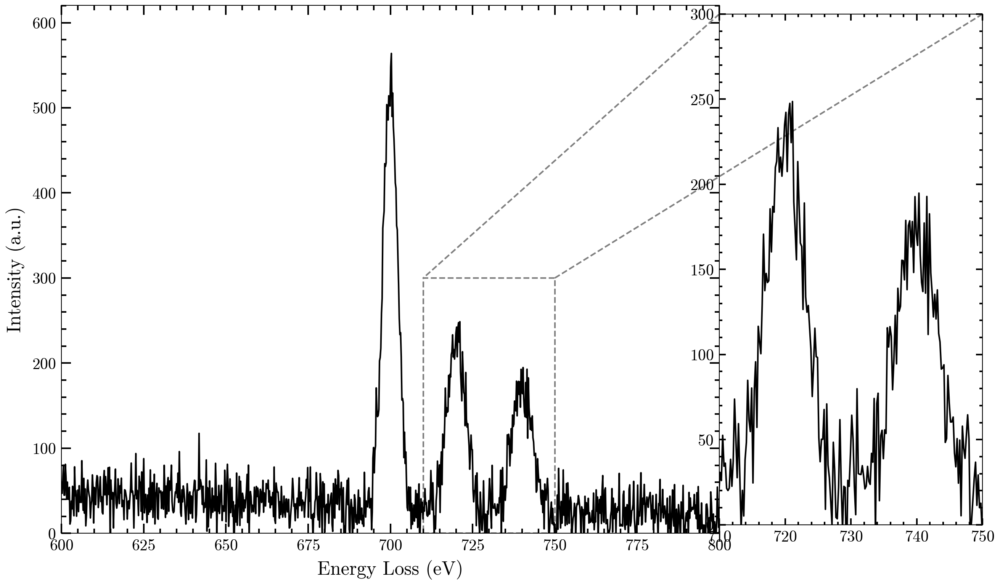

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset

def plot_random_spectrum_with_zoom():
    # Set the style
    plt.style.use(['science', 'no-latex'])
    
    # Generate x-axis (energy loss)
    energy = np.linspace(600, 800, 1000)
    
    # Generate background
    background = 1000 * np.exp(-energy/200)
    
    # Generate peaks (simulate EELS edges)
    peak1 = 500 * np.exp(-(energy - 700)**2/10)  # Main edge
    peak2 = 200 * np.exp(-(energy - 720)**2/15)  # Second feature
    peak3 = 150 * np.exp(-(energy - 740)**2/20)  # Third feature
    
    # Combine signals and add noise
    np.random.seed(42)  # for reproducibility
    signal = background + peak1 + peak2 + peak3
    noise = np.random.normal(0, 20, size=len(energy))
    final_spectrum = signal + noise
    
    # Create figure with larger right margin
    fig, ax = plt.subplots(figsize=(10, 6), dpi=300)
    
    # Plot the spectrum
    ax.plot(energy, final_spectrum, 'k-', linewidth=1)
    
    # Set main axis limits
    ax.set_xlim(600, 800)
    ax.set_ylim(0, np.max(final_spectrum)*1.1)
    
    # Create zoomed inset axes outside main plot
    axins = zoomed_inset_axes(ax, zoom=2, bbox_to_anchor=(1.2, 0.5),
                             bbox_transform=ax.transAxes,
                             loc='center')
    
    # Plot the data in the inset
    axins.plot(energy, final_spectrum, 'k-', linewidth=1)
    
    # Set the limits for the inset
    axins.set_xlim(710, 750)  # zoom area x limits
    axins.set_ylim(0, 300)  # zoom area y limits
    
    # Style the inset
    axins.tick_params(axis='both', which='major', direction='in', length=4, width=1)
    axins.tick_params(axis='both', which='minor', direction='in', length=2, width=1)
    axins.grid(False)
    
    # Add connecting lines
    mark_inset(ax, axins, loc1=1, loc2=2, fc="none", ec="gray", linestyle="--")
    
    # Customize the main plot
    ax.set_xlabel('Energy Loss (eV)', fontsize=12)
    ax.set_ylabel('Intensity (a.u.)', fontsize=12)
    ax.tick_params(which='major', direction='in', length=6, width=1)
    ax.tick_params(which='minor', direction='in', length=3, width=1)
    
    # Remove grid
    ax.grid(False)
    
    # Adjust layout to make room for the zoom window
    plt.subplots_adjust(right=0.7)
    
    return fig

# Create and show the plot
fig = plot_random_spectrum_with_zoom()
plt.show()